# Importing Libraries
This notebook demonstrates the use of two different COVID-19 data sources for the U.S.
Set `data_source = 'usafacts'` if you'd like to pull data from https://usafacts.org.
Set `data_source = 'jhu_csse'` if you'd lke to use data from Johns Hopkins CSSE.

In [1]:
data_source = 'jhu_csse'

In [2]:
import pandas as pd
import matplotlib.pyplot as plt
from fp_covid19.data.bears import Bears
if data_source == 'usafacts':
  from fp_covid19.data.usafacts import (
      get_covid19_us_bears, get_us_population, attribution)
elif data_source == 'jhu_csse':
  from fp_covid19.data.jhu_csse import (
      get_covid19_us_bears, get_us_population, attribution)
from fp_covid19.cases.compute import (
    new_cases, per_capita, check_cumulatives, to_epoch)
from fp_covid19.visualization.folium_helper import *
from fp_covid19.visualization.geojson_helper import (
  read_geo_pandas, USPS_PUB28_DF, US_NYC_FIPS)

# Convert CSV Files to `Bears` Objects
Let's convert the U.S. COVID-19 time-series CSV files to `Bears` objects. A `Bears` object has a Pandas `DataFrame` and properties that separate time-series columns from other columns.
As of 8 Apr., 2020, both Johns Hopkins and USAFacts host two U.S. CSV files with county-level data. One file is for confirmed cases and the other for deaths.
The function `get_covid19_us_bears()` computes state-level data from county-level data, returning four `Bears` objects in one dictionary.

In [3]:
country = 'US'
covid19 = {}
covid19[country] = get_covid19_us_bears()
for db_type, dicts in covid19[country].items():
  for geo_level, bears in dicts.items():
    display(db_type, geo_level, bears)

'confirmed'

'counties'

,iso2,iso3,code3,FIPS,Admin2,Province_State,Country_Region,Lat,Long_,Combined_Key,...,4/16/2020,4/17/2020,4/18/2020,4/19/2020,4/20/2020,4/21/2020,4/22/2020,4/23/2020,4/24/2020,4/25/2020
UID,,,,,,,,,,,,,,,,,,,,,
16.0,AS,ASM,16,60,NaN,American Samoa,US,-14.271000,-170.132000,"American Samoa, US",...,0,0,0,0,0,0,0,0,0,0
316.0,GU,GUM,316,66,NaN,Guam,US,13.444300,144.793700,"Guam, US",...,135,136,136,136,136,136,136,139,141,141
580.0,MP,MNP,580,69,NaN,Northern Mariana Islands,US,15.097900,145.673900,"Northern Mariana Islands, US",...,13,13,14,14,14,14,14,14,14,14
630.0,PR,PRI,630,72,NaN,Puerto Rico,US,18.220800,-66.590100,"Puerto Rico, US",...,1043,1068,1118,1213,1252,1298,1252,1416,1276,1307
850.0,VI,VIR,850,78,NaN,Virgin Islands,US,18.335800,-64.896300,"Virgin Islands, US",...,51,51,53,53,53,53,54,54,54,55
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
84070017.0,US,USA,840,-9223372036854775808,Southeast Utah,Utah,US,38.996171,-110.701396,"Southeast Utah, Utah, US",...,0,0,0,6,7,7,7,7,8,11
84070018.0,US,USA,840,-9223372036854775808,Southwest Utah,Utah,US,37.854472,-111.441876,"Southwest Utah, Utah, US",...,0,0,0,66,70,70,70,76,81,83
84070019.0,US,USA,840,-9223372036854775808,TriCounty,Utah,US,40.124915,-109.517442,"TriCounty, Utah, US",...,0,0,0,10,10,10,9,9,9,9


'confirmed'

'states'

,1/22/2020,1/23/2020,1/24/2020,1/25/2020,1/26/2020,1/27/2020,1/28/2020,1/29/2020,1/30/2020,1/31/2020,...,4/16/2020,4/17/2020,4/18/2020,4/19/2020,4/20/2020,4/21/2020,4/22/2020,4/23/2020,4/24/2020,4/25/2020
Province_State,,,,,,,,,,,,,,,,,,,,,
Alabama,0,0,0,0,0,0,0,0,0,0,...,4345,4571,4712,4888,5079,5317,5593,5832,6026,6026
Alaska,0,0,0,0,0,0,0,0,0,0,...,300,309,314,319,321,329,335,337,339,339
American Samoa,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
Arizona,0,0,0,0,1,1,1,1,1,1,...,4237,4511,4724,4933,5068,5256,5473,5772,6045,6286
Arkansas,0,0,0,0,0,0,0,0,0,0,...,1620,1695,1744,1781,1973,1990,2276,2599,2810,2911
California,0,0,0,0,2,2,2,2,2,3,...,27677,29157,30491,31431,33686,35465,37344,39561,41355,42368
Colorado,0,0,0,0,0,0,0,0,0,0,...,8286,8691,9047,9730,9730,10473,10891,11278,12256,12968
Connecticut,0,0,0,0,0,0,0,0,0,0,...,15884,16809,17550,17962,19815,20360,22469,23100,23936,24583
Delaware,0,0,0,0,0,0,0,0,0,0,...,2070,2317,2538,2538,2745,2931,3200,3308,3442,3576


'deaths'

'counties'

,iso2,iso3,code3,FIPS,Admin2,Province_State,Country_Region,Lat,Long_,Combined_Key,...,4/16/2020,4/17/2020,4/18/2020,4/19/2020,4/20/2020,4/21/2020,4/22/2020,4/23/2020,4/24/2020,4/25/2020
UID,,,,,,,,,,,,,,,,,,,,,
16.0,AS,ASM,16,60,NaN,American Samoa,US,-14.271000,-170.132000,"American Samoa, US",...,0,0,0,0,0,0,0,0,0,0
316.0,GU,GUM,316,66,NaN,Guam,US,13.444300,144.793700,"Guam, US",...,5,5,5,5,5,5,5,5,5,5
580.0,MP,MNP,580,69,NaN,Northern Mariana Islands,US,15.097900,145.673900,"Northern Mariana Islands, US",...,2,2,2,2,2,2,2,2,2,2
630.0,PR,PRI,630,72,NaN,Puerto Rico,US,18.220800,-66.590100,"Puerto Rico, US",...,56,58,60,62,63,64,63,69,77,83
850.0,VI,VIR,850,78,NaN,Virgin Islands,US,18.335800,-64.896300,"Virgin Islands, US",...,1,2,3,3,3,3,3,3,3,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
84070017.0,US,USA,840,-9223372036854775808,Southeast Utah,Utah,US,38.996171,-110.701396,"Southeast Utah, Utah, US",...,0,0,0,0,0,0,0,0,0,0
84070018.0,US,USA,840,-9223372036854775808,Southwest Utah,Utah,US,37.854472,-111.441876,"Southwest Utah, Utah, US",...,0,0,0,1,1,1,1,1,1,2
84070019.0,US,USA,840,-9223372036854775808,TriCounty,Utah,US,40.124915,-109.517442,"TriCounty, Utah, US",...,0,0,0,0,0,0,0,0,0,0


'deaths'

'states'

,1/22/2020,1/23/2020,1/24/2020,1/25/2020,1/26/2020,1/27/2020,1/28/2020,1/29/2020,1/30/2020,1/31/2020,...,4/16/2020,4/17/2020,4/18/2020,4/19/2020,4/20/2020,4/21/2020,4/22/2020,4/23/2020,4/24/2020,4/25/2020
Province_State,,,,,,,,,,,,,,,,,,,,,
Alabama,0,0,0,0,0,0,0,0,0,0,...,133,148,153,157,163,183,196,202,209,209
Alaska,0,0,0,0,0,0,0,0,0,0,...,9,9,9,9,9,9,9,9,9,9
American Samoa,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
Arizona,0,0,0,0,0,0,0,0,0,0,...,164,183,180,184,191,208,231,249,266,273
Arkansas,0,0,0,0,0,0,0,0,0,0,...,37,37,38,39,41,42,42,45,47,48
California,0,0,0,0,0,0,0,0,0,0,...,956,1037,1140,1177,1225,1282,1421,1533,1621,1689
Colorado,0,0,0,0,0,0,0,0,0,0,...,355,372,389,420,420,483,506,552,674,684
Connecticut,0,0,0,0,0,0,0,0,0,0,...,971,1036,1086,1127,1331,1423,1544,1639,1767,1865
Delaware,0,0,0,0,0,0,0,0,0,0,...,55,61,67,67,72,82,89,92,100,112


# Quick Sanity Checks
The cumulative data are often not exactly cumulative.

In [4]:
not_monotonic_increasing_index, not_exactly_cumulatives = check_cumulatives(covid19[country])
display('Non-monotonically increasing data points', not_exactly_cumulatives.style.format('{:.2%}'))

'Non-monotonically increasing data points'

,Confirmed,Deaths
Counties (3262 items),31.94%,7.69%
States (58 items),24.14%,25.86%


# Total U.S. Cases

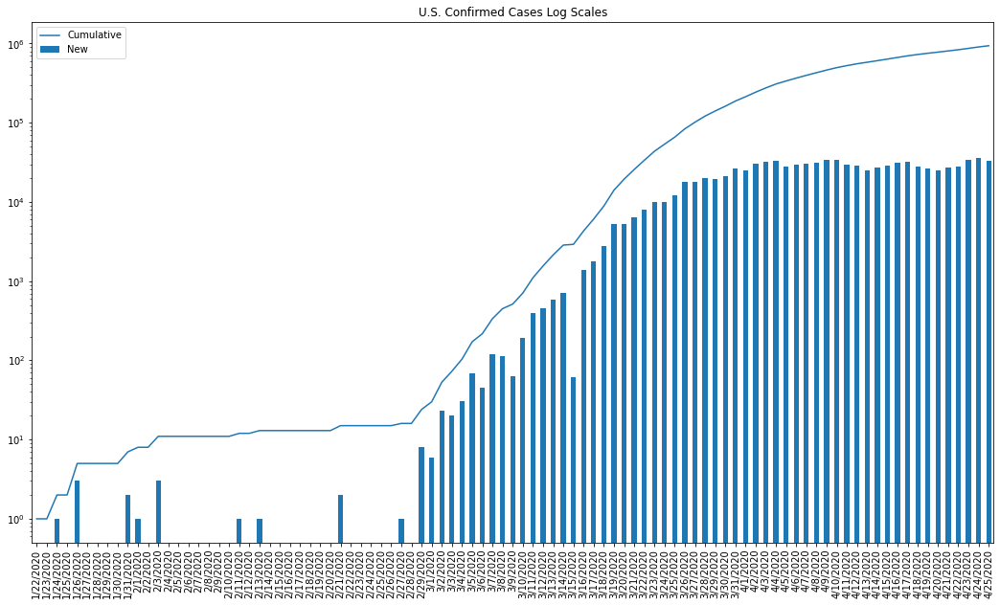

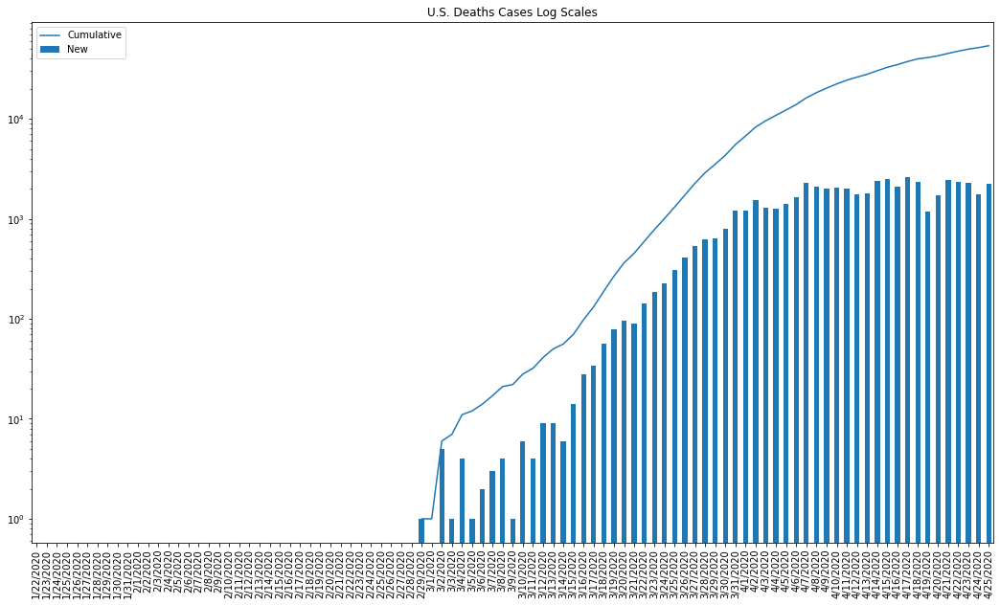

In [5]:
logy = True
db_types = ['confirmed', 'deaths']
for db_type in db_types: 
  bears = covid19[country][db_type]['states']
  series = bears.df.sum()
  series_diff = series[bears.datetime_index].diff()
  ax = series.plot(
      title=('U.S. {db_type} {scale}'
             .format(
                 db_type=db_type.capitalize(),
                 scale='Log Scales' if logy else '')),
      logy=logy,)
  series_diff.plot.bar(
      title=('U.S. {db_type} Cases {scale}'
             .format(
                 db_type=db_type.capitalize(),
                 scale='Log Scales' if logy else '')),
      logy=logy,
      figsize=[18, 10],
      ax=ax
  )
  ax.legend(['Cumulative', 'New'])
  plt.show()

#  Cumulative and New Cases for U.S. States and Counties

Review the top $k$ confrimed and death cases by county and by state. Plot *cumulative* confirmed cases as lines and *new* cases as bars on a log scale. Use the new-case bar chart to see whether the curve is rising exponentially, getting flat, or declining. From the new-case chart, we do not want to see a new wave of infections.

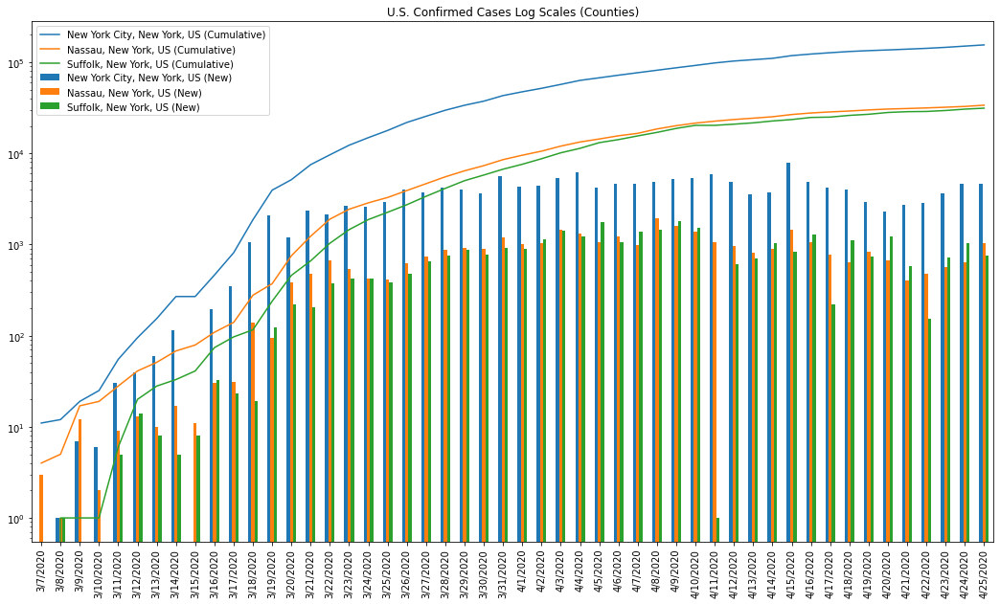

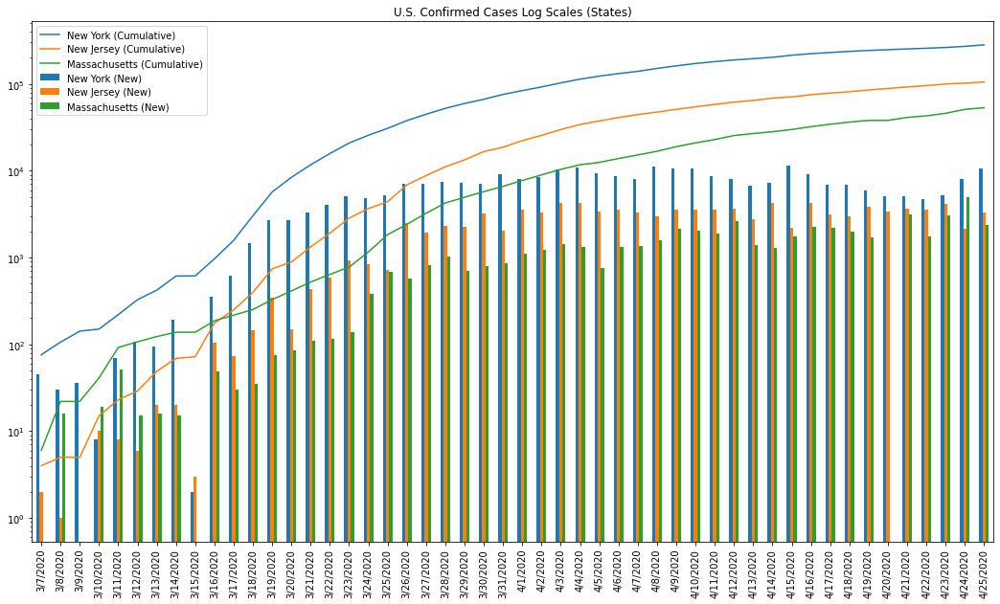

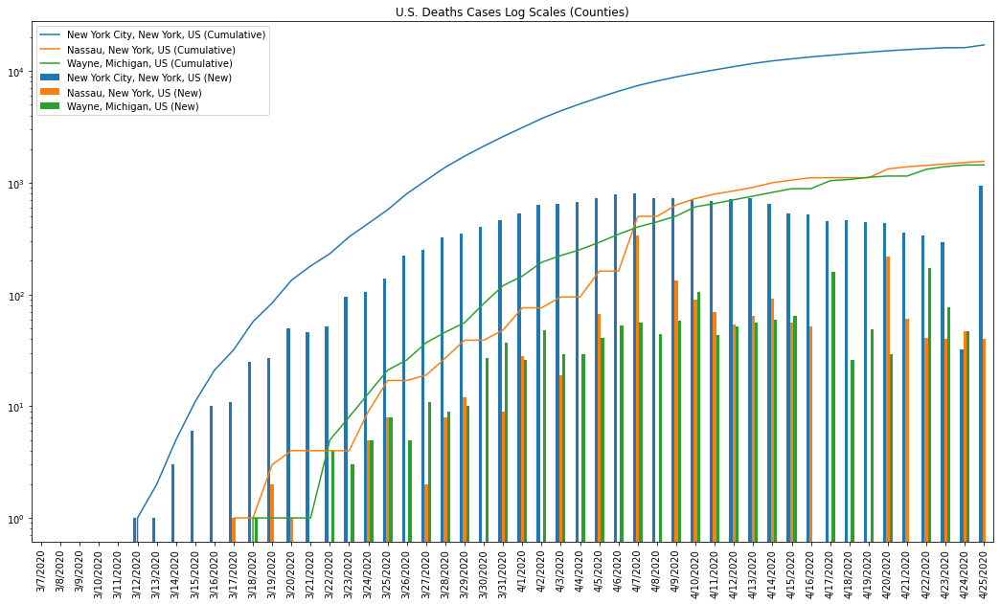

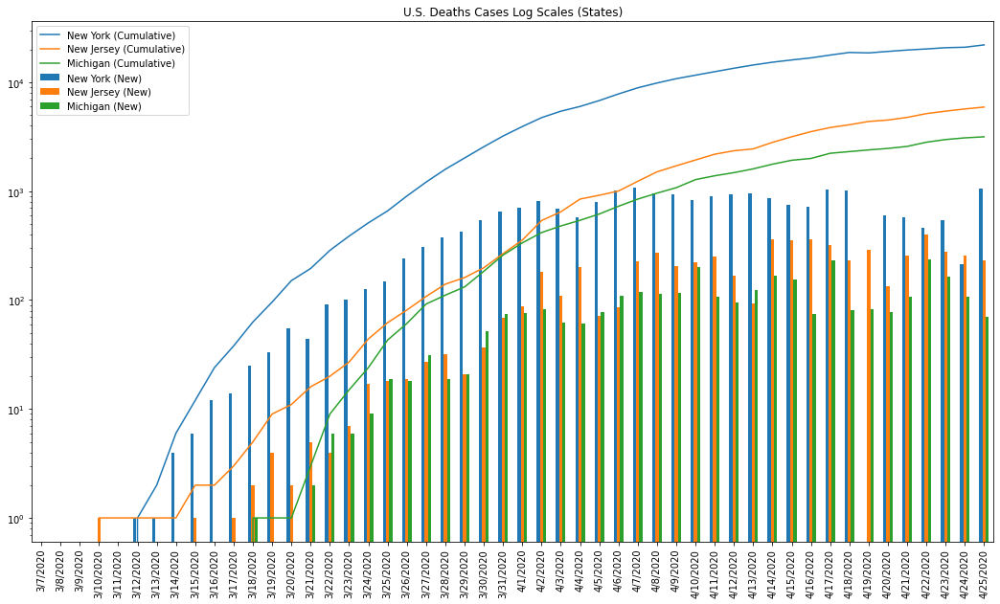

In [6]:
top_k = 3
period = 50
logy = True
for db_type, dicts in covid19[country].items():
  for geo_level, bears in dicts.items():
    top_k_bears = Bears(
        dataframe=bears.df.nlargest(top_k, bears.df.columns[-1]))
    df = top_k_bears.df
    df_diff = new_cases(top_k_bears).df
    if geo_level == 'counties':
      df = df.set_index(['Admin2', 'Province_State'])
      df_diff = df_diff.set_index(['Admin2', 'Province_State'])
    ax = df[df.columns[-period:]].T.plot(
        logy=logy,
        figsize=[18, 10],)
    ax = df_diff[df.columns[-period:]].T.plot.bar(
        title=('U.S. {db_type} Cases {scale} ({geo_level})'
               .format(
                   db_type=db_type.capitalize(),
                   scale='Log Scales' if logy else '',
                   geo_level=geo_level.capitalize())
              ),
        logy=logy,
        ax=ax,
    )
    legend_labels = (df.Combined_Key.values if geo_level == 'counties'
                     else df.index.values)
    ax.legend(list(legend_labels + ' (Cumulative)') + 
              list(legend_labels + ' (New)'))

# Download County Populations and Derive State Populations

In [7]:
population = get_us_population()
display(population['counties'].head())

,FIPS,Admin2,Province_State,Population
UID,,,,
16.0,60,NaN,American Samoa,55641
316.0,66,NaN,Guam,164229
580.0,69,NaN,Northern Mariana Islands,55144
630.0,72,NaN,Puerto Rico,2933408
850.0,78,NaN,Virgin Islands,107268


In [8]:
display(population['states'].sort_values(by='Population', ascending=False).head())

,Population,Province_State
index,,
California,39512223,California
Texas,28995881,Texas
New York,23628065,New York
Florida,21477737,Florida
Pennsylvania,12801989,Pennsylvania


# Cases Per Capita

In [9]:
covid19_per_capita = {
    'US': #TODO: recovered and deaths not implemented
    {'confirmed': {'counties': None, 'states': None},
     'deaths': {'counties': None, 'states': None}}}

top_k = 5
for db_type in ['confirmed', 'deaths']:
  for geo_level in ['states', 'counties']:
    covid19_per_capita[country][db_type][geo_level] = per_capita(
        covid19[country][db_type][geo_level],
        population[geo_level]['Population'])
    display('Top-{} Per Capita {} ({})'.format(
        top_k, db_type.capitalize(), geo_level.capitalize()),
        covid19_per_capita[country][db_type][geo_level].df.nlargest(
            top_k, covid19_per_capita[country][db_type][geo_level].datetime_index[-1]))

'Top-5 Per Capita Confirmed (States)'

,1/22/2020,1/23/2020,1/24/2020,1/25/2020,1/26/2020,1/27/2020,1/28/2020,1/29/2020,1/30/2020,1/31/2020,...,4/16/2020,4/17/2020,4/18/2020,4/19/2020,4/20/2020,4/21/2020,4/22/2020,4/23/2020,4/24/2020,4/25/2020
Province_State,,,,,,,,,,,,,,,,,,,,,
New York,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.009467,0.009759,0.010051,0.010301,0.010514,0.010730,0.010929,0.011150,0.011494,0.011941
New Jersey,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.008480,0.008834,0.009167,0.009604,0.009989,0.010401,0.010798,0.011261,0.011506,0.011877
Massachusetts,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.004669,0.004991,0.005277,0.005524,0.005524,0.005977,0.006231,0.006677,0.007395,0.007740
Connecticut,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.004455,0.004715,0.004922,0.005038,0.005558,0.005711,0.006302,0.006479,0.006714,0.006895
Rhode Island,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.003331,0.003943,0.004239,0.004442,0.004805,0.005192,0.005514,0.005905,0.006324,0.006730


'Top-5 Per Capita Confirmed (Counties)'

,iso2,iso3,code3,FIPS,Admin2,Province_State,Country_Region,Lat,Long_,Combined_Key,...,4/16/2020,4/17/2020,4/18/2020,4/19/2020,4/20/2020,4/21/2020,4/22/2020,4/23/2020,4/24/2020,4/25/2020
UID,,,,,,,,,,,,,,,,,,,,,
84005079.0,US,USA,840,5079,Lincoln,Arkansas,US,33.953172,-91.740028,"Lincoln, Arkansas, US",...,0.004684,0.007217,0.008446,0.008523,0.019810,0.019810,0.034168,0.048372,0.054284,0.055359
84047007.0,US,USA,840,47007,Bledsoe,Tennessee,US,35.599430,-85.206120,"Bledsoe, Tennessee, US",...,0.000465,0.000465,0.000531,0.000597,0.000664,0.000730,0.000730,0.023301,0.038834,0.038901
84036087.0,US,USA,840,36087,Rockland,New York,US,41.150279,-74.025605,"Rockland, New York, US",...,0.026864,0.027585,0.028150,0.028743,0.029028,0.029369,0.029771,0.030167,0.030974,0.034044
84039101.0,US,USA,840,39101,Marion,Ohio,US,40.586107,-83.157363,"Marion, Ohio, US",...,0.004240,0.006575,0.015101,0.028175,0.031847,0.032753,0.032830,0.033199,0.033322,0.033368
84039129.0,US,USA,840,39129,Pickaway,Ohio,US,39.641704,-83.024339,"Pickaway, Ohio, US",...,0.003353,0.004328,0.005166,0.008160,0.021315,0.027969,0.028363,0.028414,0.028380,0.028431


'Top-5 Per Capita Deaths (States)'

,1/22/2020,1/23/2020,1/24/2020,1/25/2020,1/26/2020,1/27/2020,1/28/2020,1/29/2020,1/30/2020,1/31/2020,...,4/16/2020,4/17/2020,4/18/2020,4/19/2020,4/20/2020,4/21/2020,4/22/2020,4/23/2020,4/24/2020,4/25/2020
Province_State,,,,,,,,,,,,,,,,,,,,,
New York,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000708,0.000751,0.000794,0.000786,0.000812,0.000836,0.000855,0.000878,0.000887,0.000931
New Jersey,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000396,0.000432,0.000458,0.000491,0.000506,0.000535,0.000580,0.000611,0.000640,0.000666
Connecticut,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000272,0.000291,0.000305,0.000316,0.000373,0.000399,0.000433,0.000460,0.000496,0.000523
Massachusetts,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000161,0.000181,0.000204,0.000248,0.000248,0.000285,0.000317,0.000342,0.000371,0.000396
Louisiana,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000249,0.000261,0.000273,0.000279,0.000286,0.000302,0.000317,0.000344,0.000357,0.000367


'Top-5 Per Capita Deaths (Counties)'

,iso2,iso3,code3,FIPS,Admin2,Province_State,Country_Region,Lat,Long_,Combined_Key,...,4/16/2020,4/17/2020,4/18/2020,4/19/2020,4/20/2020,4/21/2020,4/22/2020,4/23/2020,4/24/2020,4/25/2020
UID,,,,,,,,,,,,,,,,,,,,,
84036061.0,US,USA,840,36061,New York,New York,US,40.767273,-73.971526,"New York City, New York, US",...,0.002305,0.002382,0.002463,0.002539,0.002614,0.002676,0.002734,0.002784,0.002790,0.002951
84013243.0,US,USA,840,13243,Randolph,Georgia,US,31.766228,-84.757324,"Randolph, Georgia, US",...,0.001033,0.001770,0.001770,0.001918,0.002213,0.002361,0.002508,0.002656,0.002656,0.002803
84013273.0,US,USA,840,13273,Terrell,Georgia,US,31.775275,-84.440697,"Terrell, Georgia, US",...,0.001407,0.001524,0.001641,0.001641,0.002110,0.002110,0.002110,0.002110,0.001993,0.001993
84022095.0,US,USA,840,22095,St. John the Baptist,Louisiana,US,30.125975,-90.475350,"St. John the Baptist, Louisiana, US",...,0.001097,0.001167,0.001237,0.001237,0.001237,0.001331,0.001331,0.001377,0.001471,0.001494
84013099.0,US,USA,840,13099,Early,Georgia,US,31.321553,-84.902552,"Early, Georgia, US",...,0.000589,0.000785,0.000785,0.000785,0.000981,0.000981,0.001178,0.001472,0.001472,0.001472


In [10]:
us_population = population['states']['Population'].sum()
display(us_population)

336218660

# Convert county borders from GeoJSON file to GeoPandas

In [11]:
import geopandas as gpd

In [12]:
covid19_gdf = {country: {}}
covid19_gdf[country] = read_geo_pandas()

In [13]:
covid19_gdf[country]['counties']['tmp_stateFIPS'] = (
    covid19_gdf[country]['counties']
    .id.str[:-3])
covid19_gdf[country]['counties'] = (
    covid19_gdf[country]['counties'].merge(
        left_on='tmp_stateFIPS',
        right=USPS_PUB28_DF[['stateFIPS', 'USPS', 'Province_State']],
        right_on='stateFIPS')).drop('tmp_stateFIPS', axis='columns')
covid19_gdf[country]['counties'].loc[:, 'Combined_Key'] = (
    covid19_gdf[country]['counties']['name']
    .combine(
        covid19_gdf[country]['counties']['Province_State'],
        lambda s1, s2: s1 + ', ' + s2))
covid19_gdf[country]['counties'].loc[:, 'id2'] = covid19_gdf[country]['counties'].id.copy().str.lstrip('0')
covid19_gdf[country]['counties'].set_index('id2', inplace=True)


covid19_gdf[country]['states'].id = covid19_gdf[country]['states'].id.str.lstrip('0')
covid19_gdf[country]['states']['id2'] = covid19_gdf[country]['states'].id.copy().str.lstrip('0')
covid19_gdf[country]['states'].set_index('id2', inplace=True)
covid19_gdf[country]['states'].index = covid19_gdf[country]['states'].index.map(str)
covid19_gdf[country]['states']['Combined_Key'] = covid19_gdf[country]['states']['name'].copy()

In [14]:
display(covid19_gdf['US']['states'].head(), covid19_gdf['US']['counties'].head())

,id,name,geometry,Combined_Key
id2,,,,
1,1,Alabama,"POLYGON ((-87.35930 35.00118, -85.60667 34.984...",Alabama
2,2,Alaska,"MULTIPOLYGON (((-131.60202 55.11798, -131.5691...",Alaska
4,4,Arizona,"POLYGON ((-109.04250 37.00026, -109.04798 31.3...",Arizona
5,5,Arkansas,"POLYGON ((-94.47384 36.50186, -90.15254 36.496...",Arkansas
6,6,California,"POLYGON ((-123.23326 42.00619, -122.37885 42.0...",California


,id,name,StCo_FIPSC,AreaSqKM,geometry,stateFIPS,USPS,Province_State,Combined_Key
id2,,,,,,,,,
1017,1017,Chambers,1017,1562.057367,"POLYGON ((-85.59318 33.10734, -85.51975 33.108...",1,AL,Alabama,"Chambers, Alabama"
1013,1013,Butler,1013,2014.703850,"POLYGON ((-86.90590 31.75304, -86.90690 31.830...",1,AL,Alabama,"Butler, Alabama"
1019,1019,Cherokee,1019,1553.931854,"POLYGON ((-85.84362 34.20001, -85.84380 34.244...",1,AL,Alabama,"Cherokee, Alabama"
1063,1063,Greene,1063,1709.198324,"POLYGON ((-88.17185 32.99586, -88.16286 33.015...",1,AL,Alabama,"Greene, Alabama"
1065,1065,Hale,1065,1700.330587,"POLYGON ((-87.71571 33.00682, -87.62041 33.004...",1,AL,Alabama,"Hale, Alabama"


# Any FIPS missing from the GeoJSON?

In [15]:
counties_gdf = covid19_gdf[country]['counties']
covid19_counties_df = covid19['US']['confirmed']['counties'].df
# Filter out FIPS that end with '000' since they refer to unallocated regions
display('counties_gdf.index.str.endswith("000"):',  counties_gdf[counties_gdf.index.str.endswith('000')])
display('covid19_counties_df.FIPS.str.endswith("000"):', covid19_counties_df.FIPS.str.endswith('000'))
display('covid19_counties_df first entry:', covid19_counties_df.FIPS.head(2).str.endswith('000'))
fips_in_geojson_but_not_covid19 = counties_gdf.loc[
    ~counties_gdf.index.isin(covid19_counties_df.FIPS)]
fips_in_covid19_but_not_geojson = covid19_counties_df.loc[
    ~covid19_counties_df.FIPS.isin(counties_gdf.index)]
display('FIPS in GeoJSON but not COVID-19 dataframe: ',
        len(fips_in_geojson_but_not_covid19),
        fips_in_geojson_but_not_covid19)
with pd.option_context("display.max_rows", 1000):
    display('FIPS in COVID-19 dataframe but not GeoJSON: ',
        len(fips_in_covid19_but_not_geojson),
        fips_in_covid19_but_not_geojson.query('Admin2 != "Statewide Unallocated"'))

'counties_gdf.index.str.endswith("000"):'

,id,name,StCo_FIPSC,AreaSqKM,geometry,stateFIPS,USPS,Province_State,Combined_Key
id2,,,,,,,,,


'covid19_counties_df.FIPS.str.endswith("000"):'

UID
16.0          False
316.0         False
580.0         False
630.0         False
850.0         False
              ...  
84070017.0    False
84070018.0    False
84070019.0    False
84070020.0    False
NaN           False
Name: FIPS, Length: 3262, dtype: bool

'covid19_counties_df first entry:'

UID
16.0     False
316.0    False
Name: FIPS, dtype: bool

'FIPS in GeoJSON but not COVID-19 dataframe: '

86

,id,name,StCo_FIPSC,AreaSqKM,geometry,stateFIPS,USPS,Province_State,Combined_Key
id2,,,,,,,,,
60010,60010,Eastern,60010,414.849074,"POLYGON ((-170.66633 -14.37578, -170.73215 -14...",60,AS,American Samoa,"Eastern, American Samoa"
60050,60050,Western,60050,269.226443,"POLYGON ((-170.79716 -14.24664, -170.73215 -14...",60,AS,American Samoa,"Western, American Samoa"
60040,60040,Swains Island,60040,151.603068,"POLYGON ((-171.14118 -11.04661, -171.13745 -11...",60,AS,American Samoa,"Swains Island, American Samoa"
60030,60030,Rose Island,60030,147.465895,"POLYGON ((-168.22527 -14.53591, -168.21848 -14...",60,AS,American Samoa,"Rose Island, American Samoa"
60020,60020,Manu'a,60020,521.858986,"POLYGON ((-169.63135 -14.22797, -169.66061 -14...",60,AS,American Samoa,"Manu'a, American Samoa"
...,...,...,...,...,...,...,...,...,...
72054,72054,Florida,72054,39.425511,"POLYGON ((-66.58818 18.38941, -66.56431 18.413...",72,PR,Puerto Rico,"Florida, Puerto Rico"
72101,72101,Morovis,72101,100.815705,"POLYGON ((-66.46321 18.37147, -66.44380 18.371...",72,PR,Puerto Rico,"Morovis, Puerto Rico"
78030,78030,St. Thomas,78030,799.030793,"POLYGON ((-64.84373 18.39371, -64.84371 18.349...",78,VI,U.S. Virgin Islands,"St. Thomas, U.S. Virgin Islands"


'FIPS in COVID-19 dataframe but not GeoJSON: '

120

,iso2,iso3,code3,FIPS,Admin2,Province_State,Country_Region,Lat,Long_,Combined_Key,...,4/16/2020,4/17/2020,4/18/2020,4/19/2020,4/20/2020,4/21/2020,4/22/2020,4/23/2020,4/24/2020,4/25/2020
UID,,,,,,,,,,,,,,,,,,,,,
16.0,AS,ASM,16,60,NaN,American Samoa,US,-14.271000,-170.132000,"American Samoa, US",...,0,0,0,0,0,0,0,0,0,0
316.0,GU,GUM,316,66,NaN,Guam,US,13.444300,144.793700,"Guam, US",...,135,136,136,136,136,136,136,139,141,141
580.0,MP,MNP,580,69,NaN,Northern Mariana Islands,US,15.097900,145.673900,"Northern Mariana Islands, US",...,13,13,14,14,14,14,14,14,14,14
630.0,PR,PRI,630,72,NaN,Puerto Rico,US,18.220800,-66.590100,"Puerto Rico, US",...,1043,1068,1118,1213,1252,1298,1252,1416,1276,1307
850.0,VI,VIR,850,78,NaN,Virgin Islands,US,18.335800,-64.896300,"Virgin Islands, US",...,51,51,53,53,53,53,54,54,54,55
84070002.0,US,USA,840,-9223372036854775808,Dukes and Nantucket,Massachusetts,US,41.406747,-70.687635,"Dukes and Nantucket,Massachusetts,US",...,21,21,23,23,23,23,23,23,24,24
84070003.0,US,USA,840,-9223372036854775808,Kansas City,Missouri,US,39.099700,-94.578600,"Kansas City,Missouri,US",...,386,401,412,418,420,438,448,461,475,486
84080001.0,US,USA,840,80001,Out of AL,Alabama,US,0.000000,0.000000,"Out of AL, Alabama, US",...,0,0,0,0,0,0,0,0,0,0
84080002.0,US,USA,840,80002,Out of AK,Alaska,US,0.000000,0.000000,"Out of AK, Alaska, US",...,0,0,0,0,0,0,0,0,0,0


# New York City

Some databases do not break out data for the five boroughs in New York City and instead assign their cases to New York County (Manhattan).
The five FIPS for New York City are in the list `US_NYC_FIPS`.
+ Bronx
+ Kings (Brooklyn), 
+ New York (Manhattan), 
+ Queens,
+ Richmond (Staten Island)

In [16]:
counties_gdf[counties_gdf.index.isin(US_NYC_FIPS)]

,id,name,StCo_FIPSC,AreaSqKM,geometry,stateFIPS,USPS,Province_State,Combined_Key
id2,,,,,,,,,
36047,36047,Kings,36047,250.770442,"POLYGON ((-74.05574 40.65176, -74.03457 40.684...",36,NY,New York,"Kings, New York"
36005,36005,Bronx,36005,148.597465,"POLYGON ((-73.91791 40.91758, -73.83841 40.894...",36,NY,New York,"Bronx, New York"
36061,36061,New York,36061,87.232257,"POLYGON ((-73.98479 40.79769, -73.96318 40.826...",36,NY,New York,"New York, New York"
36085,36085,Richmond,36085,264.925366,"POLYGON ((-74.20369 40.59269, -74.20225 40.630...",36,NY,New York,"Richmond, New York"
36081,36081,Queens,36081,461.099600,"POLYGON ((-74.03629 40.55104, -73.87922 40.574...",36,NY,New York,"Queens, New York"


In [17]:
for db_type in ['confirmed', 'deaths']:
  display(
      db_type,
      covid19['US'][db_type]['counties'].df[
        covid19['US'][db_type]['counties'].df.FIPS.isin(US_NYC_FIPS)
      ])

'confirmed'

,iso2,iso3,code3,FIPS,Admin2,Province_State,Country_Region,Lat,Long_,Combined_Key,...,4/16/2020,4/17/2020,4/18/2020,4/19/2020,4/20/2020,4/21/2020,4/22/2020,4/23/2020,4/24/2020,4/25/2020
UID,,,,,,,,,,,,,,,,,,,,,
84036005.0,US,USA,840,36005,Bronx,New York,US,40.852093,-73.862828,"Bronx, New York, US",...,0,0,0,0,0,0,0,0,0,0
84036047.0,US,USA,840,36047,Kings,New York,US,40.636183,-73.949356,"Kings, New York, US",...,0,0,0,0,0,0,0,0,0,0
84036061.0,US,USA,840,36061,New York,New York,US,40.767273,-73.971526,"New York City, New York, US",...,123146,127352,131334,134267,136591,139348,142227,145855,150473,155113
84036081.0,US,USA,840,36081,Queens,New York,US,40.710881,-73.816847,"Queens, New York, US",...,0,0,0,0,0,0,0,0,0,0
84036085.0,US,USA,840,36085,Richmond,New York,US,40.585822,-74.148086,"Richmond, New York, US",...,0,0,0,0,0,0,0,0,0,0


'deaths'

,iso2,iso3,code3,FIPS,Admin2,Province_State,Country_Region,Lat,Long_,Combined_Key,...,4/16/2020,4/17/2020,4/18/2020,4/19/2020,4/20/2020,4/21/2020,4/22/2020,4/23/2020,4/24/2020,4/25/2020
UID,,,,,,,,,,,,,,,,,,,,,
84036005.0,US,USA,840,36005,Bronx,New York,US,40.852093,-73.862828,"Bronx, New York, US",...,0,0,0,0,0,0,0,0,0,0
84036047.0,US,USA,840,36047,Kings,New York,US,40.636183,-73.949356,"Kings, New York, US",...,0,0,0,0,0,0,0,0,0,0
84036061.0,US,USA,840,36061,New York,New York,US,40.767273,-73.971526,"New York City, New York, US",...,13374,13826,14291,14735,15169,15529,15864,16158,16190,17126
84036081.0,US,USA,840,36081,Queens,New York,US,40.710881,-73.816847,"Queens, New York, US",...,0,0,0,0,0,0,0,0,0,0
84036085.0,US,USA,840,36085,Richmond,New York,US,40.585822,-74.148086,"Richmond, New York, US",...,0,0,0,0,0,0,0,0,0,0


# Build Folium ToolTip for Choropleths

In [18]:
counties_with_covid_gdf = counties_gdf
# Merge confirmed and death cases, count and per capita
for db_type in ['confirmed', 'deaths']:
  for right_bear in [covid19[country][db_type]['counties'], 
                     covid19_per_capita[country][db_type]['counties']]:
    counties_with_covid_gdf = (pd.merge(
        left=counties_with_covid_gdf,
        left_on='id',
        right=right_bear.df.loc[
            :, ['FIPS', right_bear.datetime_index[-1]]],
        right_on='FIPS')
        .drop(columns='FIPS')
        .rename(columns={
            right_bear.datetime_index[-1]: db_type + (
                '_per_capita'
                if right_bear == covid19_per_capita[country][db_type]['counties']
                else '')}))
# Merge population
counties_with_covid_gdf = (
  pd.merge(
      left=counties_with_covid_gdf,
      left_on='id',
      right=population['counties'],
      right_on='FIPS')
  .drop(columns='FIPS')
)

# Read https://www.medrxiv.org/content/10.1101/2020.02.19.20025163v1.full.pdf and
# https://wwwnc.cdc.gov/eid/article/26/6/20-0320_article first before calling anything
# case fatality rate.
#counties_with_covid_gdf = counties_with_covid_gdf.assign(
#   case_fatality_rate=lambda x: x.deaths/x.confirmed)


In [19]:
counties_with_covid_gdf.head()

,id,name,StCo_FIPSC,AreaSqKM,geometry,stateFIPS,USPS,Province_State_x,Combined_Key,confirmed,confirmed_per_capita,deaths,deaths_per_capita,Admin2,Province_State_y,Population
0,1017,Chambers,1017,1562.057367,"POLYGON ((-85.59318 33.10734, -85.51975 33.108...",1,AL,Alabama,"Chambers, Alabama",282,0.008480,17,0.000511,Chambers,Alabama,33254
1,1013,Butler,1013,2014.703850,"POLYGON ((-86.90590 31.75304, -86.90690 31.830...",1,AL,Alabama,"Butler, Alabama",21,0.001080,0,0.000000,Butler,Alabama,19448
2,1019,Cherokee,1019,1553.931854,"POLYGON ((-85.84362 34.20001, -85.84380 34.244...",1,AL,Alabama,"Cherokee, Alabama",12,0.000458,0,0.000000,Cherokee,Alabama,26196
3,1063,Greene,1063,1709.198324,"POLYGON ((-88.17185 32.99586, -88.16286 33.015...",1,AL,Alabama,"Greene, Alabama",44,0.005425,0,0.000000,Greene,Alabama,8111
4,1065,Hale,1065,1700.330587,"POLYGON ((-87.71571 33.00682, -87.62041 33.004...",1,AL,Alabama,"Hale, Alabama",39,0.002662,2,0.000137,Hale,Alabama,14651


In [20]:
counties_with_covid_gdf.query('confirmed > 100').nlargest(5, 'deaths_per_capita')

,id,name,StCo_FIPSC,AreaSqKM,geometry,stateFIPS,USPS,Province_State_x,Combined_Key,confirmed,confirmed_per_capita,deaths,deaths_per_capita,Admin2,Province_State_y,Population
1862,36061,New York,36061,87.232257,"POLYGON ((-73.98479 40.79769, -73.96318 40.826...",36,NY,New York,"New York, New York",155113,0.026729,17126,0.002951,New York,New York,5803210
403,13243,Randolph,13243,1115.956364,"POLYGON ((-84.90701 31.92447, -84.65582 31.920...",13,GA,Georgia,"Randolph, Georgia",153,0.022573,19,0.002803,Randolph,Georgia,6778
498,13273,Terrell,13273,874.647141,"POLYGON ((-84.59978 31.92017, -84.45331 31.919...",13,GA,Georgia,"Terrell, Georgia",165,0.019341,17,0.001993,Terrell,Georgia,8531
1175,22095,St. John the Baptist,22095,1061.525200,"POLYGON ((-90.64200 30.16643, -90.63281 30.221...",22,LA,Louisiana,"St. John the Baptist, Louisiana",747,0.017438,64,0.001494,St. John the Baptist,Louisiana,42837
470,13099,Early,13099,1337.329354,"POLYGON ((-84.63758 31.43393, -84.63808 31.332...",13,GA,Georgia,"Early, Georgia",194,0.019038,15,0.001472,Early,Georgia,10190


For easier printing in tooltips. Combine absolute and per-capita fields. Convert per-capita data to perecentages as strings.

In [21]:
counties_with_covid_tooltip_gdf = (counties_with_covid_gdf.
 assign(
    confirmed_per_capita=lambda x: x.confirmed_per_capita.apply(
          lambda y: '{:.3%}'.format(y)),
    deaths_per_capita=lambda x: x.deaths_per_capita.apply(
          lambda y: '{:.3%}'.format(y))
 )
)
counties_with_covid_tooltip_gdf

,id,name,StCo_FIPSC,AreaSqKM,geometry,stateFIPS,USPS,Province_State_x,Combined_Key,confirmed,confirmed_per_capita,deaths,deaths_per_capita,Admin2,Province_State_y,Population
0,1017,Chambers,1017,1562.057367,"POLYGON ((-85.59318 33.10734, -85.51975 33.108...",1,AL,Alabama,"Chambers, Alabama",282,0.848%,17,0.051%,Chambers,Alabama,33254
1,1013,Butler,1013,2014.703850,"POLYGON ((-86.90590 31.75304, -86.90690 31.830...",1,AL,Alabama,"Butler, Alabama",21,0.108%,0,0.000%,Butler,Alabama,19448
2,1019,Cherokee,1019,1553.931854,"POLYGON ((-85.84362 34.20001, -85.84380 34.244...",1,AL,Alabama,"Cherokee, Alabama",12,0.046%,0,0.000%,Cherokee,Alabama,26196
3,1063,Greene,1063,1709.198324,"POLYGON ((-88.17185 32.99586, -88.16286 33.015...",1,AL,Alabama,"Greene, Alabama",44,0.542%,0,0.000%,Greene,Alabama,8111
4,1065,Hale,1065,1700.330587,"POLYGON ((-87.71571 33.00682, -87.62041 33.004...",1,AL,Alabama,"Hale, Alabama",39,0.266%,2,0.014%,Hale,Alabama,14651
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3137,56011,Crook,56011,7421.255025,"POLYGON ((-105.07660 44.99993, -105.03825 45.0...",56,WY,Wyoming,"Crook, Wyoming",5,0.066%,0,0.000%,Crook,Wyoming,7584
3138,56045,Weston,56045,6216.029978,"POLYGON ((-105.07928 44.17618, -104.72288 44.1...",56,WY,Wyoming,"Weston, Wyoming",0,0.000%,0,0.000%,Weston,Wyoming,6927
3139,56017,Hot Springs,56017,5196.555110,"POLYGON ((-109.31295 43.81329, -109.27255 43.8...",56,WY,Wyoming,"Hot Springs, Wyoming",3,0.068%,0,0.000%,Hot Springs,Wyoming,4413
3140,56009,Converse,56009,11046.455496,"POLYGON ((-106.07340 42.43324, -106.07585 42.4...",56,WY,Wyoming,"Converse, Wyoming",16,0.116%,0,0.000%,Converse,Wyoming,13822


In [22]:
counties_with_covid_tooltip_gdf = (counties_with_covid_tooltip_gdf.assign(
    confirmed_str=counties_with_covid_tooltip_gdf.confirmed.combine(
        counties_with_covid_tooltip_gdf.confirmed_per_capita,
        lambda series1, series2: np.nan_to_num(series1).astype(int).astype(str) + ' (' + series2 + ')'
    ),
    deaths_str=counties_with_covid_tooltip_gdf.deaths.combine(
        counties_with_covid_tooltip_gdf.deaths_per_capita,
        lambda series1, series2: np.nan_to_num(series1).astype(int).astype(str) + ' (' + series2 + ')'
    )
 )
 .drop(columns=['confirmed', 'confirmed_per_capita', 'deaths', 'deaths_per_capita'])
)

In [23]:
counties_with_covid_tooltip_gdf

,id,name,StCo_FIPSC,AreaSqKM,geometry,stateFIPS,USPS,Province_State_x,Combined_Key,Admin2,Province_State_y,Population,confirmed_str,deaths_str
0,1017,Chambers,1017,1562.057367,"POLYGON ((-85.59318 33.10734, -85.51975 33.108...",1,AL,Alabama,"Chambers, Alabama",Chambers,Alabama,33254,282 (0.848%),17 (0.051%)
1,1013,Butler,1013,2014.703850,"POLYGON ((-86.90590 31.75304, -86.90690 31.830...",1,AL,Alabama,"Butler, Alabama",Butler,Alabama,19448,21 (0.108%),0 (0.000%)
2,1019,Cherokee,1019,1553.931854,"POLYGON ((-85.84362 34.20001, -85.84380 34.244...",1,AL,Alabama,"Cherokee, Alabama",Cherokee,Alabama,26196,12 (0.046%),0 (0.000%)
3,1063,Greene,1063,1709.198324,"POLYGON ((-88.17185 32.99586, -88.16286 33.015...",1,AL,Alabama,"Greene, Alabama",Greene,Alabama,8111,44 (0.542%),0 (0.000%)
4,1065,Hale,1065,1700.330587,"POLYGON ((-87.71571 33.00682, -87.62041 33.004...",1,AL,Alabama,"Hale, Alabama",Hale,Alabama,14651,39 (0.266%),2 (0.014%)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3137,56011,Crook,56011,7421.255025,"POLYGON ((-105.07660 44.99993, -105.03825 45.0...",56,WY,Wyoming,"Crook, Wyoming",Crook,Wyoming,7584,5 (0.066%),0 (0.000%)
3138,56045,Weston,56045,6216.029978,"POLYGON ((-105.07928 44.17618, -104.72288 44.1...",56,WY,Wyoming,"Weston, Wyoming",Weston,Wyoming,6927,0 (0.000%),0 (0.000%)
3139,56017,Hot Springs,56017,5196.555110,"POLYGON ((-109.31295 43.81329, -109.27255 43.8...",56,WY,Wyoming,"Hot Springs, Wyoming",Hot Springs,Wyoming,4413,3 (0.068%),0 (0.000%)
3140,56009,Converse,56009,11046.455496,"POLYGON ((-106.07340 42.43324, -106.07585 42.4...",56,WY,Wyoming,"Converse, Wyoming",Converse,Wyoming,13822,16 (0.116%),0 (0.000%)


# Set up search box for Folium maps

In [27]:
import folium
from folium.plugins import (
    #TimeSliderChoropleth,
    TimestampedGeoJson,
    #Search,
)
from fp_covid19.visualization.search import Search
from fp_covid19.visualization.time_slider_choropleth import (
    TimeSliderChoropleth)

def add_us_state_county_search(
    folium_map, search_json, state_json, counties_with_tooltip_json,
    latest_date):
  state_geo_style_function = lambda x: {
      'color': 'yellow',
      'weight': 0, # Show state boundary once compatible with county boundary
      'fillOpacity':0,
  }
  state_geo = folium.GeoJson(
      state_json,
      name='US States',
      style_function=state_geo_style_function,
      control=False,
  ).add_to(folium_map)

  county_geo_style_function = lambda x: {
      'color': 'orange',
      'weight': 0.5,
      'fillOpacity':0,
  }
  county_geo = folium.GeoJson(
      counties_with_tooltip_json,
      name='US Counties',
      style_function=county_geo_style_function,
      tooltip=folium.GeoJsonTooltip(
          fields=['Combined_Key', 'confirmed_str', 'deaths_str', 'Population'],
          aliases=[latest_date, 'Confirmed', 'Deaths', 'Population'],
          localize=True
      ),
      control=False
  ).add_to(folium_map)

  search_geo = folium.GeoJson(
      search_json,
      name='County or State',
      style_function=county_geo_style_function,
      control=False
  ).add_to(folium_map)
  search_geo.add_to(folium_map)
  Search(
      layer=search_geo,
      position='topright',
      geom_type='Polygon',
      placeholder='Search for a State or a County',
      collapsed=True,
      search_label='Combined_Key',
      weight=1,
  ).add_to(folium_map)

  # Keep the county tool tip in front, so selecting layers won't obscure it
  folium_map.keep_in_front(county_geo)


# Display Data Using U.S. County and State Maps
Visualize ranked daily per-capita cases using a choropleth with a time slider.

In [28]:
location = [40, -100]
m = folium.Map(
    location=location, 
    zoom_start=4,
    zoom_control=False,
)

folium.raster_layers.TileLayer(
    tiles='https://{s}.tile.openstreetmap.org/{z}/{x}/{y}.png',
    attr=((
        ' | Presented by \u0026copy; <a href="https://first-principles.ai"/>'
        'first-principles.ai</a> on {date} '
        'using data from {data_attribution}')
        .format(
            data_attribution=attribution(),
            date=covid19[country]['confirmed']['states'].datetime_index[-1],
        )),
    name='first-principles.ai covid-19 choropleths',
    control=False,
    show=False,
).add_to(m)

folium_add_map_title(
    '<center><b>COVID-19 Per-Capita Cumulative Cases Ranked Daily by County</b></center>' 
    'Presentation \u0026copy; <a href="https://first-principles.ai">first-principles.ai</a>. ' 
    'Case data by ' + attribution() + 
    ('<a href="https://leafletjs.com/">Leaflet </a> | '
     'Data by \u0026copy; \u003ca href="http://openstreetmap.org\"'
     '\u003eOpenStreetMap\u003c/a\u003e, under \u003ca '
     'href="http://www.openstreetmap.org/copyright"'
     '\u003eODbL\u003c/a\u003e.'),
    m)

# Example style dictionary for TimeSliderChoropleth
#style_dict = {
#    "1234": {
#        to_epoch('3/20/20'): {'color': '#ff00ff', 'opacity': .8},
#        to_epoch('3/21/20'): {'color': '#00ff00', 'opacity': .8}},
#    "56789": {
#        to_epoch('3/20/20'): {'color': '#ff00ff', 'opacity': 0.8},
#        to_epoch('3/21/20'): {'color': '#00ff00', 'opacity': 0.8}}}

# normalize per-capita cases
cmap_bears = cmap_ranked_df(
    covid19_per_capita[country]['confirmed']['counties'])
opacity = 0.75
style_df = cmap_bears.df.loc[
    :, 
    ['FIPS'] + cmap_bears.datetime_index].set_index('FIPS')
style_df = style_df.rename(lambda x: to_epoch(x), axis='columns')
style_dict = {}
for fips, time_color_dict in style_df.to_dict(orient='index').items():
  style_dict[fips] = {timecode: {'color': color_str, 'opacity': opacity}
                      for timecode, color_str in time_color_dict.items()}

TimeSliderChoropleth(
    name='Daily Per-Capita Cumulative Cases Ranking',
    data=covid19_gdf[country]['counties'].to_json(),
    styledict=style_dict,
    control=True,
    init_timestamp_index=-1).add_to(m)

search_gdf = pd.concat([covid19_gdf[country]['states'],
                        covid19_gdf[country]['counties']])
add_us_state_county_search(
    m,
    search_gdf.to_json(),
    covid19_gdf[country]['states'].to_json(),
    counties_with_covid_tooltip_gdf.to_json(),
    covid19[country]['confirmed']['states'].datetime_index[-1])

folium.plugins.MousePosition().add_to(m)
m.get_root().title = 'U.S. COVID-19 Per-Capita Confrmed Cases Ranked Daily by County'
m.save('{}-per-capita-map.html'.format(data_source))
display(m)